# Set up Environment

In [58]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import statsmodels
from matplotlib import pyplot as plt

In [59]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=80, facecolor='white')

scanpy==1.5.1 anndata==0.7.3 umap==0.4.4 numpy==1.18.5 scipy==1.4.1 pandas==1.0.4 scikit-learn==0.23.1 statsmodels==0.11.1 python-igraph==0.8.2 louvain==0.7.0


# Load Data

In [60]:
dataset_names =['HN289_Pri','HN290_Pri','HN295','HN296_Pri_CD8pos','HN305_1_Pri','HN307_Pri','HN309_Pri','HN310','HN314','HN316',
          'HN290_LN2','HN291_Pri','HN296_Pri_CD8neg','HN304_Pri','HN305_2_Pri','HN307_sLN','HN309_sLN','HN313','HN315']

In [61]:
data_sets = {}
for name in dataset_names:
    file_path = '/data/'+name+'/filtered_feature_bc_matrix'
    data_sets[name] = sc.read_10x_mtx(file_path,var_names='gene_symbols',cache=True)
    data_sets[name].var_names_make_unique(join='_')
    

... reading from cache file cache/data-HN289_Pri-filtered_feature_bc_matrix-matrix.h5ad
... reading from cache file cache/data-HN290_Pri-filtered_feature_bc_matrix-matrix.h5ad
... reading from cache file cache/data-HN295-filtered_feature_bc_matrix-matrix.h5ad
... reading from cache file cache/data-HN296_Pri_CD8pos-filtered_feature_bc_matrix-matrix.h5ad
... reading from cache file cache/data-HN305_1_Pri-filtered_feature_bc_matrix-matrix.h5ad
... reading from cache file cache/data-HN307_Pri-filtered_feature_bc_matrix-matrix.h5ad
... reading from cache file cache/data-HN309_Pri-filtered_feature_bc_matrix-matrix.h5ad
... reading from cache file cache/data-HN310-filtered_feature_bc_matrix-matrix.h5ad
... reading from cache file cache/data-HN314-filtered_feature_bc_matrix-matrix.h5ad
... reading from cache file cache/data-HN316-filtered_feature_bc_matrix-matrix.h5ad
... reading from cache file cache/data-HN290_LN2-filtered_feature_bc_matrix-matrix.h5ad
... reading from cache file cache/data-

Check that all files are loaded, there should be 19 samples in total

In [62]:
len(data_sets)

19

Adding group and sample labels to the data objects

In [63]:
# sample label
for name in dataset_names: 
    data_sets[name].obs['sample'] = name
# group label
for name in dataset_names:
    if name.find('LN')!=-1:
        data_sets[name].obs['group'] = 'Metastatic'
    else:
        data_sets[name].obs['group'] = 'Primary'
        

Merging all datasets

In [64]:
combined = data_sets['HN289_Pri'].concatenate(data_sets[name] for name in data_sets if name!='HN289_Pri')

In [65]:
combined

AnnData object with n_obs × n_vars = 106238 × 33538
    obs: 'sample', 'group', 'batch'
    var: 'gene_ids', 'feature_types'

# QC Metrics

In [66]:
sc.pp.calculate_qc_metrics(combined, inplace=True)

In [67]:
# Check the computed metric names
# log1p: log(X+1) transform
combined

AnnData object with n_obs × n_vars = 106238 × 33538
    obs: 'sample', 'group', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'gene_ids', 'feature_types', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

Next compute metrics for mitochondrial genes and ribosomal genes

In [68]:
# Mitochondrial genes
mito_genes = combined.var_names.str.startswith('MT-')
# for each cell compute fraction of counts in mito genes vs. all genes
# the `.A1` is only necessary as X is sparse (to transform to a dense array after summing)
combined.obs['percent_mito'] = np.sum(combined[:, mito_genes].X, axis=1).A1 / np.sum(combined.X, axis=1).A1
# add the total counts per cell as observations-annotation to adata
combined.obs['n_counts'] = combined.X.sum(axis=1).A1

In [69]:
sum(mito_genes)

13

In [70]:
# Ribosomal genes
ribo_genes = combined.var_names.str.startswith(("RPS","RPL"))
combined.obs['percent_ribo'] = np.sum(combined[:, ribo_genes].X, axis=1).A1 / np.sum(combined.X, axis=1).A1

print(sum(ribo_genes))

104


# QC Filtering

## Primary Filtering for all

In [71]:
sc.pp.filter_cells(combined, min_genes=200)
sc.pp.filter_genes(combined, min_cells=3)

filtered out 26922 cells that have less than 200 genes expressed
filtered out 7870 genes that are detected in less than 3 cells


In [72]:
kept_cell = {} # kept_cell holds all the cells and genes that are not filtered

We then filter sample by sample since the number of cells vary significantly across samples. The overall idea is:

(1) Look at the original distributions, and determine the filter thresholds 
(2) Usually, filter below the double bellies of the violin plot, if the lower belly is somewhat much smaller than the top belly, whatever lies below probably are dead cells, broken cells) at the bottome and needles on top (probably multiplets)
(3) Filter according to the threshold and plot again to see if the violin plots look like a good violin

## Cell-filtering for HN289_Pri

In [73]:
HN289_Pri = combined[combined.obs['sample']=='HN289_Pri']

/usr/local/lib/python3.6/dist-packages/anndata/_core/anndata.py:1210: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


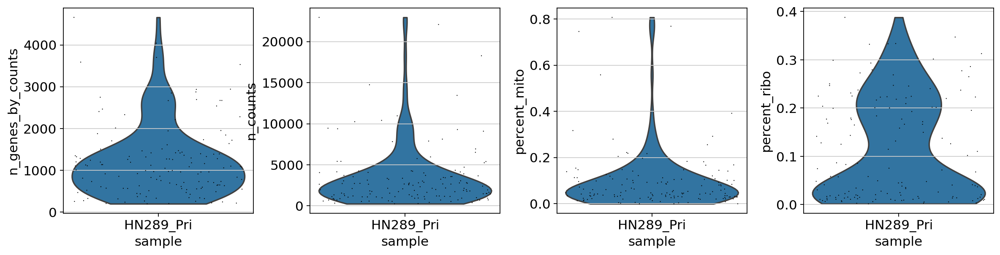

In [74]:
# Plotting QC metrics
# n_counts: total number of reads per cell
# n_genes_by_counts: the number mapped genes 
# percent_mito: percent of mitochondrial reads in total number of reads
# percent_ribo: percent of ribosomal reads in total number of reads
sc.pl.violin(HN289_Pri, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


Filtered out 74 cells, number left in HN289_Pri is 68


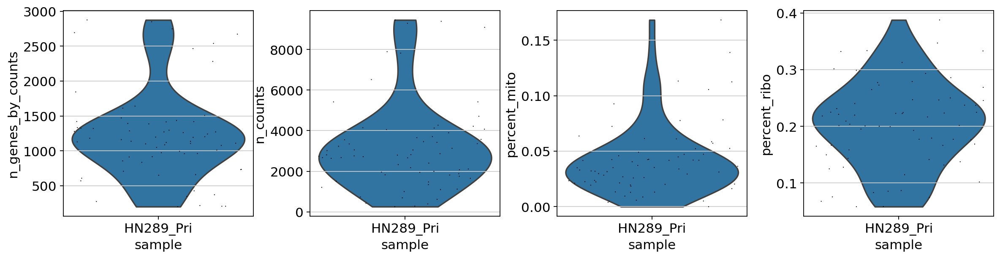

In [75]:
# filter for HN289_Pri
kept_cell['HN289_Pri'] = (combined.obs['n_counts'] < 10000) & (combined.obs['sample'] == 'HN289_Pri') & (combined.obs['percent_mito'] < 0.4) & (combined.obs['percent_ribo'] > 0.05)
number_filtered = str(len(combined[combined.obs['sample']=='HN289_Pri'].obs['total_counts'])-sum(kept_cell['HN289_Pri']))
print("Filtered out {} cells, number left in HN289_Pri is {}".format(number_filtered,str(sum(kept_cell['HN289_Pri']))))
sc.pl.violin(combined[kept_cell['HN289_Pri'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

## Cell-filtering for HN290_Pri

Look at the original distributions

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


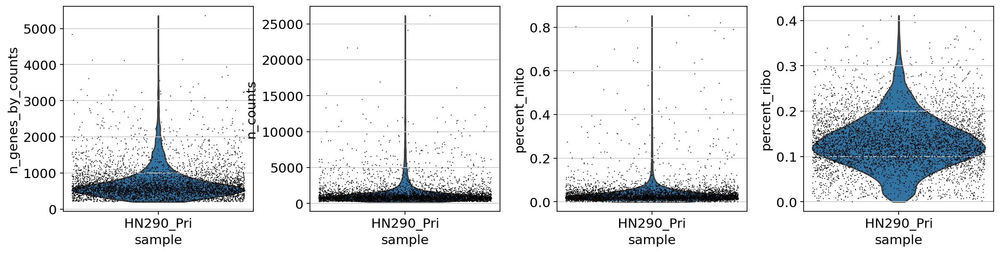

In [76]:
HN290_Pri = combined[combined.obs['sample']=='HN290_Pri']
sc.pl.violin(HN290_Pri, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


Filtered out 902 cells, number left in HN290_Pri is 4328


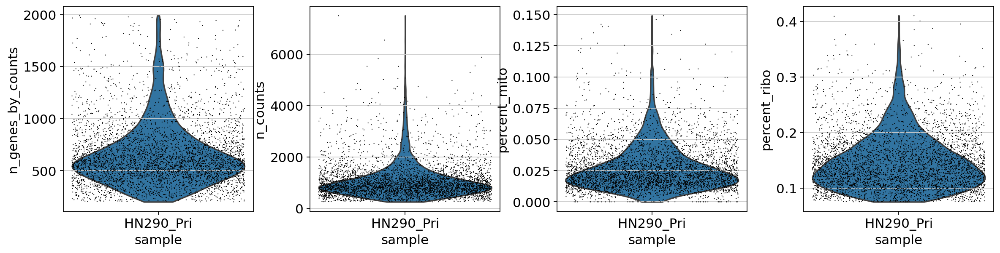

In [77]:
kept_cell['HN290_Pri'] = (combined.obs['n_genes_by_counts'] < 2000) & (combined.obs['sample'] == 'HN290_Pri') & (combined.obs['percent_mito'] < 0.15) & (combined.obs['percent_ribo'] > 0.075)
number_filtered = str(len(combined[combined.obs['sample']=='HN290_Pri'].obs['total_counts'])-sum(kept_cell['HN290_Pri']))
print("Filtered out {} cells, number left in HN290_Pri is {}".format(number_filtered,str(sum(kept_cell['HN290_Pri']))))
sc.pl.violin(combined[kept_cell['HN290_Pri'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

## Cell-filtering for HN290_LN2

Look at the original distributions

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


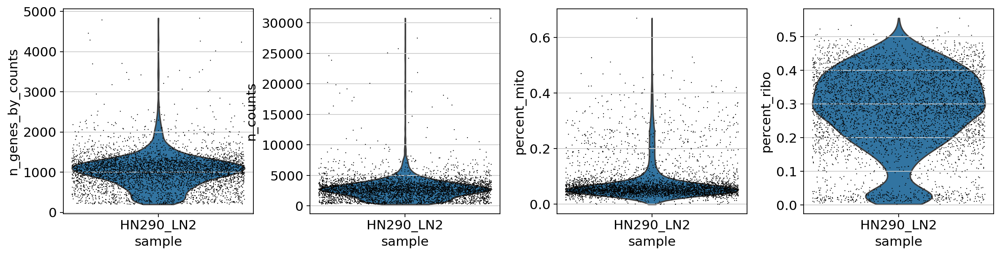

In [78]:
HN290_LN2 = combined[combined.obs['sample']=='HN290_LN2']
sc.pl.violin(HN290_LN2, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


Filtered out 418 cells, number left in HN290_LN2 is 4114


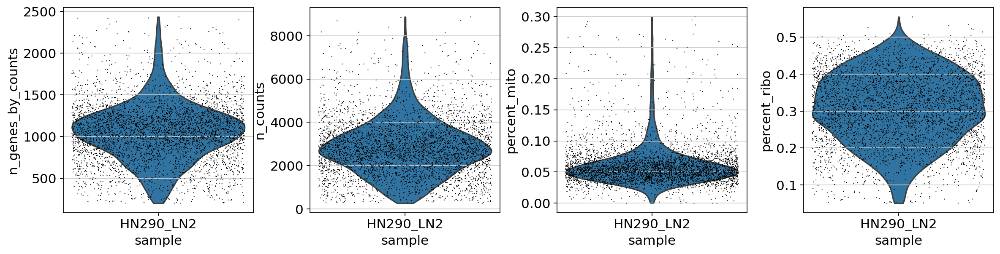

In [79]:
kept_cell['HN290_LN2'] = (combined.obs['n_genes_by_counts'] < 2500) & (combined.obs['sample'] == 'HN290_LN2') & (combined.obs['n_counts'] <9000) & (combined.obs['percent_mito'] < 0.3) & (combined.obs['percent_ribo'] > 0.05)
number_filtered = str(len(combined[combined.obs['sample']=='HN290_LN2'].obs['total_counts'])-sum(kept_cell['HN290_LN2']))
print("Filtered out {} cells, number left in HN290_LN2 is {}".format(number_filtered,str(sum(kept_cell['HN290_LN2']))))
sc.pl.violin(combined[kept_cell['HN290_LN2'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

## Cell-filtering for HN291_Pri

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


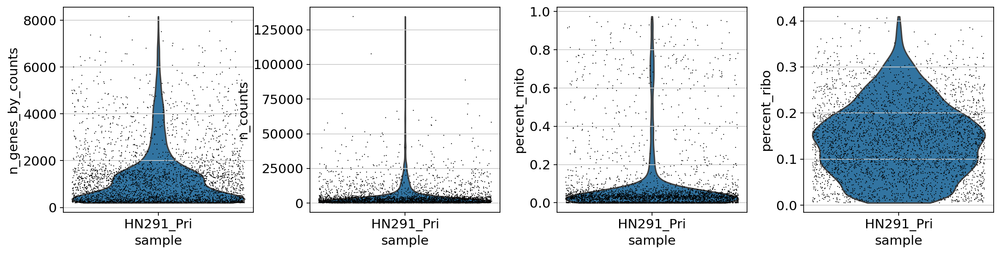

In [80]:
HN291_Pri = combined[combined.obs['sample']=='HN291_Pri']
sc.pl.violin(HN291_Pri, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


Filtered out 1916 cells, number left in HN291_Pri is 1710


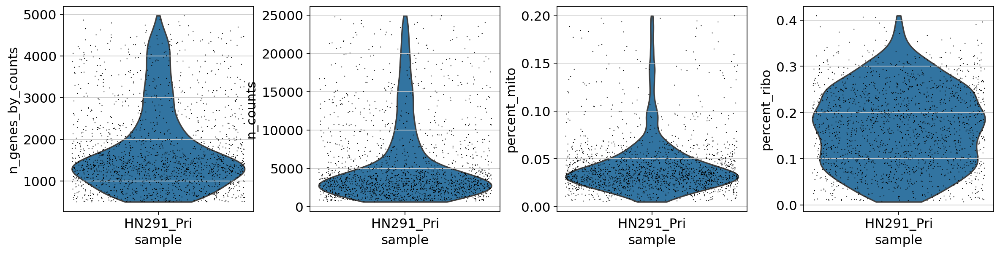

In [81]:
kept_cell['HN291_Pri'] = (combined.obs['n_genes_by_counts'] < 5000) &(combined.obs['n_genes_by_counts'] > 500) &(combined.obs['percent_mito'] > 0.005)& (combined.obs['sample'] == 'HN291_Pri') & (combined.obs['n_counts'] <25000) & (combined.obs['percent_mito'] < 0.20)
number_filtered = str(len(combined[combined.obs['sample']=='HN291_Pri'].obs['total_counts'])-sum(kept_cell['HN291_Pri']))
print("Filtered out {} cells, number left in HN291_Pri is {}".format(number_filtered,str(sum(kept_cell['HN291_Pri']))))
sc.pl.violin(combined[kept_cell['HN291_Pri'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

## Cell-filtering for HN295

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


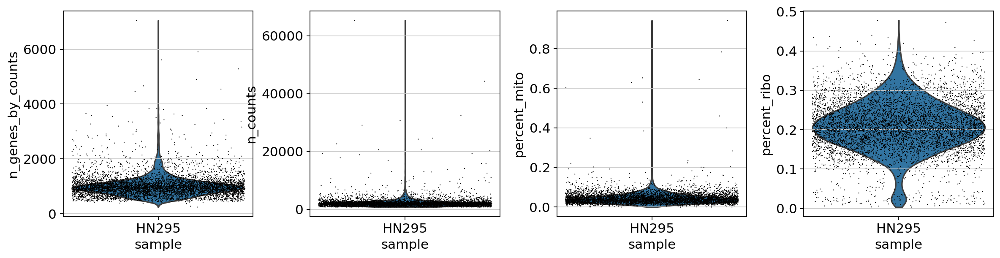

In [82]:
HN295 = combined[combined.obs['sample']=='HN295']
sc.pl.violin(HN295, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


Filtered out 233 cells, number left in HN295 is 5744


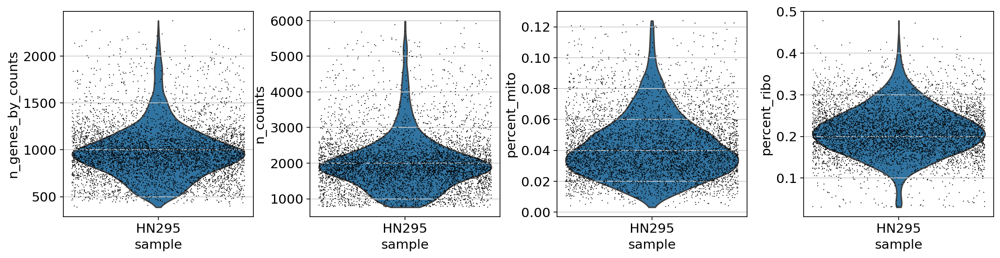

In [83]:
kept_cell['HN295'] = (combined.obs['n_genes_by_counts'] <2500) &(combined.obs['percent_mito'] > 0.002)& (combined.obs['sample'] == 'HN295') & (combined.obs['n_counts'] <6000) & (combined.obs['percent_mito'] < 0.125)& (combined.obs['percent_ribo'] > 0.03)
number_filtered = str(len(combined[combined.obs['sample']=='HN295'].obs['total_counts'])-sum(kept_cell['HN295']))
print("Filtered out {} cells, number left in HN295 is {}".format(number_filtered,str(sum(kept_cell['HN295']))))
sc.pl.violin(combined[kept_cell['HN295'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

## Cell-filtering for HN296_Pri_CD8pos

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


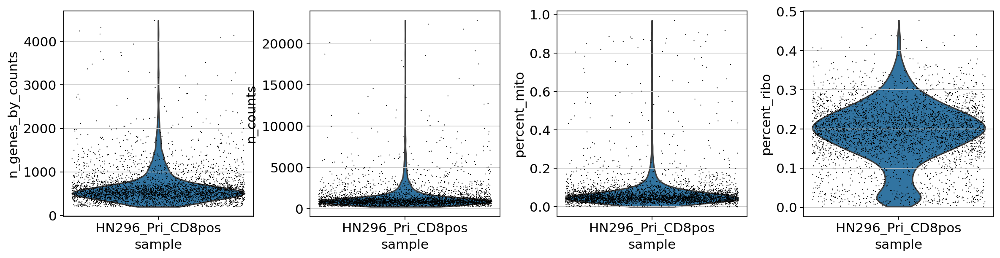

In [84]:
HN296_Pri_CD8pos = combined[combined.obs['sample']=='HN296_Pri_CD8pos']
sc.pl.violin(HN296_Pri_CD8pos, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


Filtered out 476 cells, number left in HN296_Pri_CD8pos is 3214


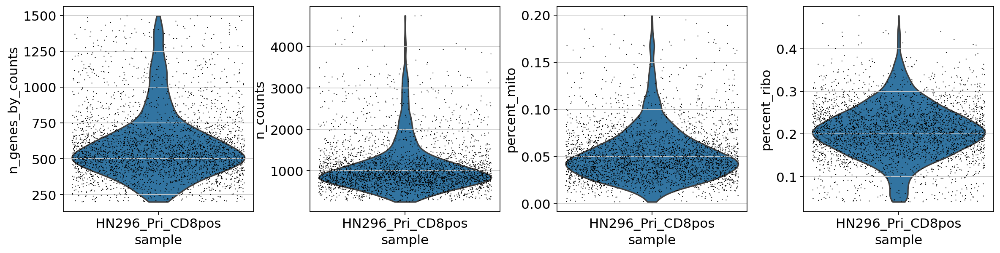

In [85]:
kept_cell['HN296_Pri_CD8pos'] = (combined.obs['n_genes_by_counts'] <1500) &(combined.obs['percent_mito'] > 0.002)& (combined.obs['sample'] == 'HN296_Pri_CD8pos') & (combined.obs['n_counts'] <5000) & (combined.obs['percent_mito'] < 0.20)& (combined.obs['percent_ribo'] > 0.04)
number_filtered = str(len(combined[combined.obs['sample']=='HN296_Pri_CD8pos'].obs['total_counts'])-sum(kept_cell['HN296_Pri_CD8pos']))
print("Filtered out {} cells, number left in HN296_Pri_CD8pos is {}".format(number_filtered,str(sum(kept_cell['HN296_Pri_CD8pos']))))
sc.pl.violin(combined[kept_cell['HN296_Pri_CD8pos'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

## Cell-filtering for HN296_Pri_CD8neg

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


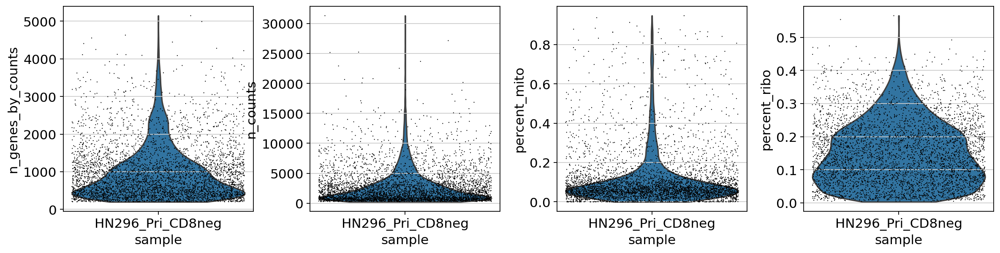

In [86]:
HN296_Pri_CD8neg = combined[combined.obs['sample']=='HN296_Pri_CD8neg']
sc.pl.violin(HN296_Pri_CD8neg, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


Filtered out 476 cells, number left in HN296_Pri_CD8neg is 4167


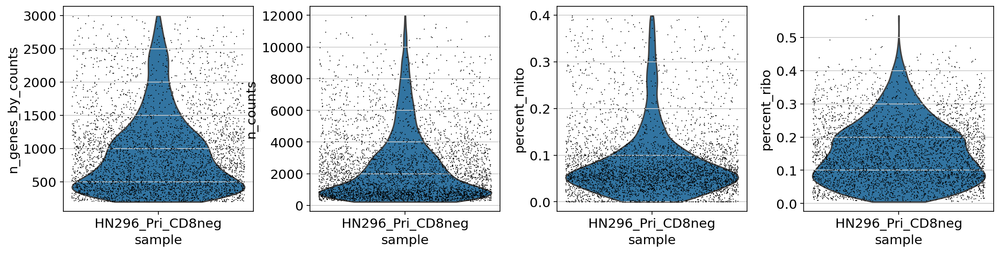

In [87]:
kept_cell['HN296_Pri_CD8neg'] = (combined.obs['n_genes_by_counts'] <3000) & (combined.obs['sample'] == 'HN296_Pri_CD8neg') & (combined.obs['n_counts'] <12000) & (combined.obs['percent_mito'] < 0.4)
print("Filtered out {} cells, number left in HN296_Pri_CD8neg is {}".format(number_filtered,str(sum(kept_cell['HN296_Pri_CD8neg']))))
sc.pl.violin(combined[kept_cell['HN296_Pri_CD8neg'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

## Cell-filtering for HN304_Pri

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


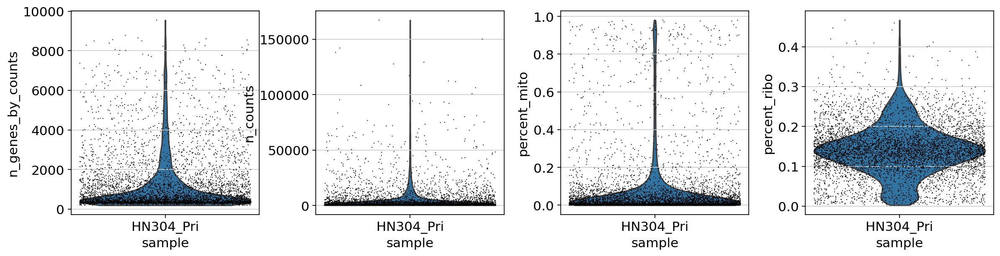

In [88]:
HN304_Pri = combined[combined.obs['sample']=='HN304_Pri']
sc.pl.violin(HN304_Pri, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


Filtered out 476 cells, number left in HN304_Pri is 3531


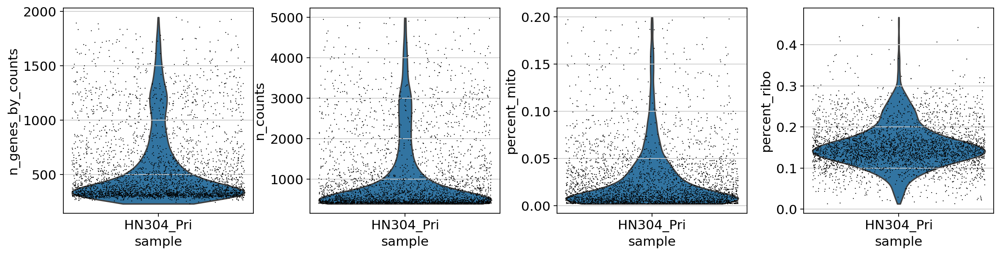

In [89]:
kept_cell['HN304_Pri'] = (combined.obs['n_genes_by_counts'] <2000) &(combined.obs['percent_mito'] > 0.002)& (combined.obs['sample'] == 'HN304_Pri') & (combined.obs['n_counts'] <5000) & (combined.obs['percent_mito'] < 0.20)
print("Filtered out {} cells, number left in HN304_Pri is {}".format(number_filtered,str(sum(kept_cell['HN304_Pri']))))
sc.pl.violin(combined[kept_cell['HN304_Pri'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

## Cell-filtering for HN305_1_Pri

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


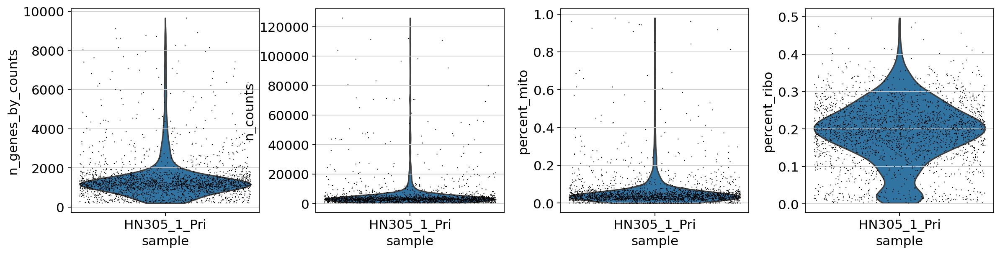

In [90]:
HN305_1_Pri = combined[combined.obs['sample']=='HN305_1_Pri']
sc.pl.violin(HN305_1_Pri, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


Filtered out 476 cells, number left in HN305_1_Pri is 2011


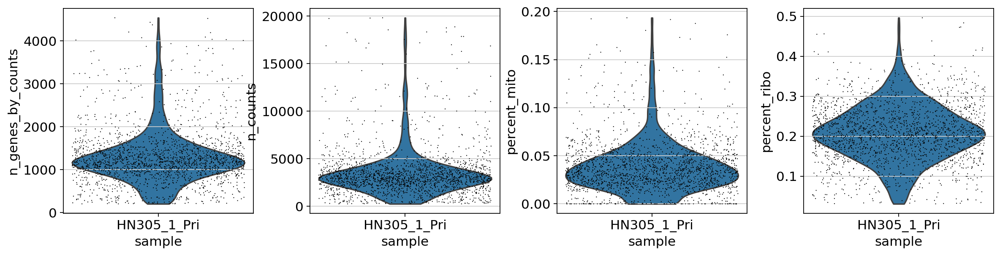

In [91]:
kept_cell['HN305_1_Pri'] = (combined.obs['n_genes_by_counts'] <6000) & (combined.obs['sample'] == 'HN305_1_Pri') & (combined.obs['n_counts'] <20000) & (combined.obs['percent_mito'] < 0.20)& (combined.obs['percent_ribo'] > 0.03)
print("Filtered out {} cells, number left in HN305_1_Pri is {}".format(number_filtered,str(sum(kept_cell['HN305_1_Pri']))))
sc.pl.violin(combined[kept_cell['HN305_1_Pri'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

## Cell-filtering for HN305_2_Pri

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


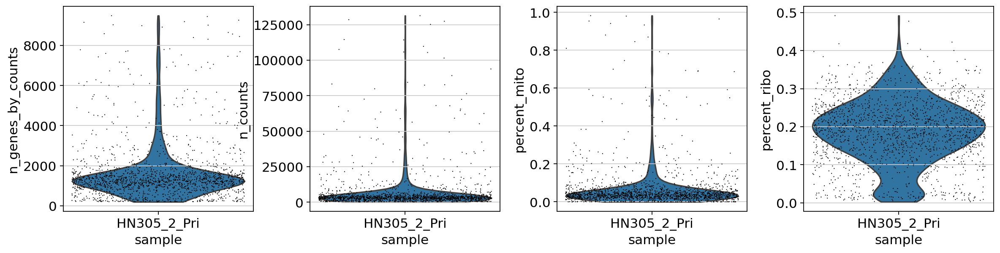

In [92]:
HN305_2_Pri = combined[combined.obs['sample']=='HN305_2_Pri']
sc.pl.violin(HN305_2_Pri, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


Filtered out 476 cells, number left in HN305_1_Pri is 1471


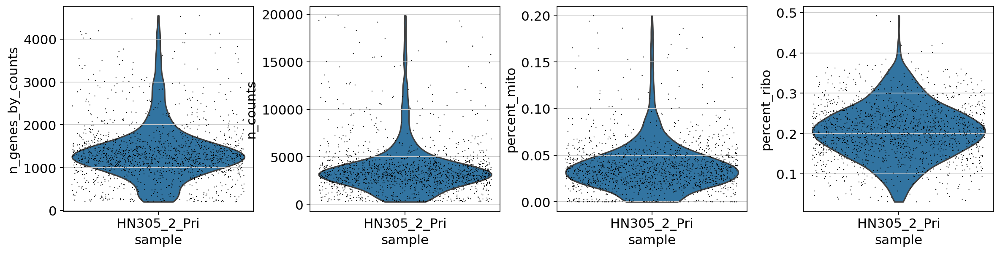

In [93]:
kept_cell['HN305_2_Pri'] = (combined.obs['n_genes_by_counts'] <6000) & (combined.obs['sample'] == 'HN305_2_Pri') & (combined.obs['n_counts'] <20000) & (combined.obs['percent_mito'] < 0.20)& (combined.obs['percent_ribo'] > 0.03)
print("Filtered out {} cells, number left in HN305_1_Pri is {}".format(number_filtered,str(sum(kept_cell['HN305_2_Pri']))))
sc.pl.violin(combined[kept_cell['HN305_2_Pri'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

## Cell-filtering for HN307_Pri

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


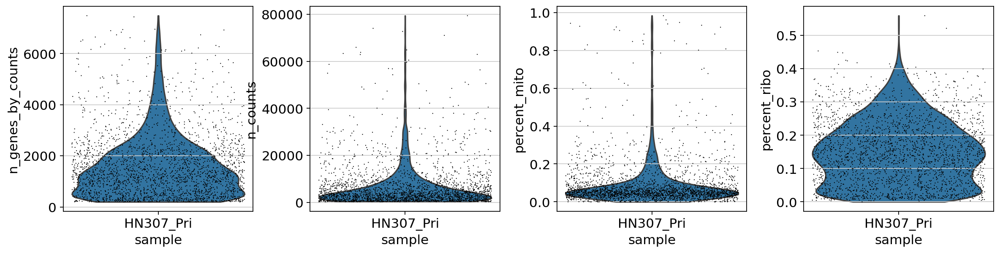

In [94]:
HN307_Pri = combined[combined.obs['sample']=='HN307_Pri']
sc.pl.violin(HN307_Pri, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


Filtered out 476 cells, number left in HN307_Pri is 2072


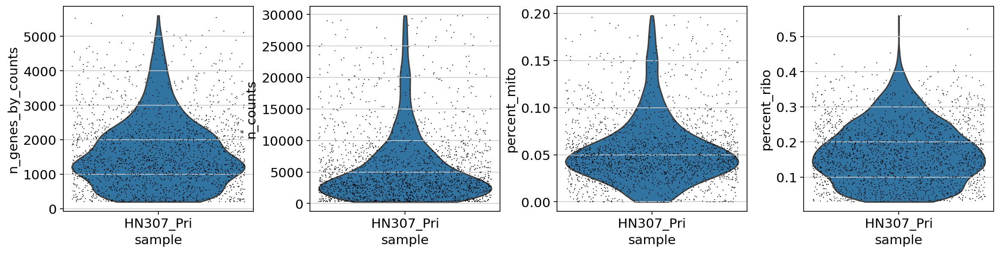

In [95]:
kept_cell['HN307_Pri'] = (combined.obs['n_genes_by_counts'] <6000) & (combined.obs['sample'] == 'HN307_Pri') & (combined.obs['n_counts'] <30000) & (combined.obs['percent_mito'] < 0.2)& (combined.obs['percent_ribo'] > 0.03)
print("Filtered out {} cells, number left in HN307_Pri is {}".format(number_filtered,str(sum(kept_cell['HN307_Pri']))))
sc.pl.violin(combined[kept_cell['HN307_Pri'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

## Cell-filtering for HN307_sLN

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


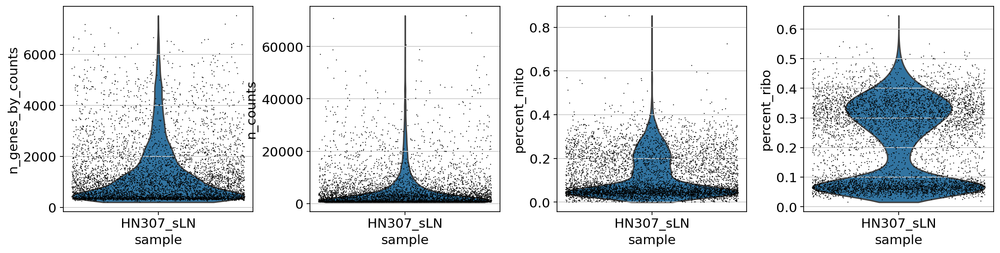

In [96]:
HN307_sLN = combined[combined.obs['sample']=='HN307_sLN']
sc.pl.violin(HN307_sLN, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


Filtered out 476 cells, number left in HN307_sLN is 5821


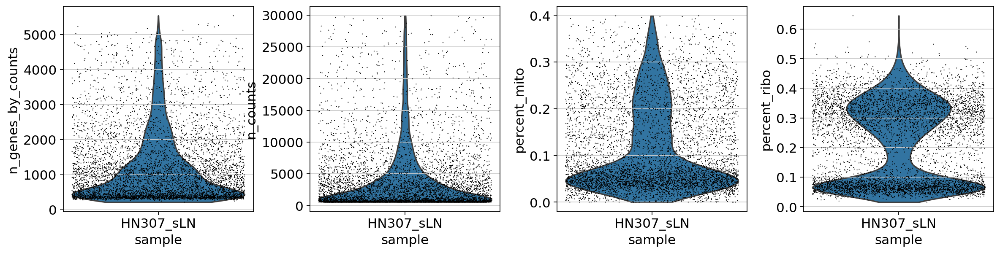

In [97]:
kept_cell['HN307_sLN'] = (combined.obs['n_genes_by_counts'] <6000) & (combined.obs['sample'] == 'HN307_sLN') & (combined.obs['n_counts'] <30000) & (combined.obs['percent_mito'] < 0.4)
print("Filtered out {} cells, number left in HN307_sLN is {}".format(number_filtered,str(sum(kept_cell['HN307_sLN']))))
sc.pl.violin(combined[kept_cell['HN307_sLN'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

## Cell-filtering for HN309_Pri

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


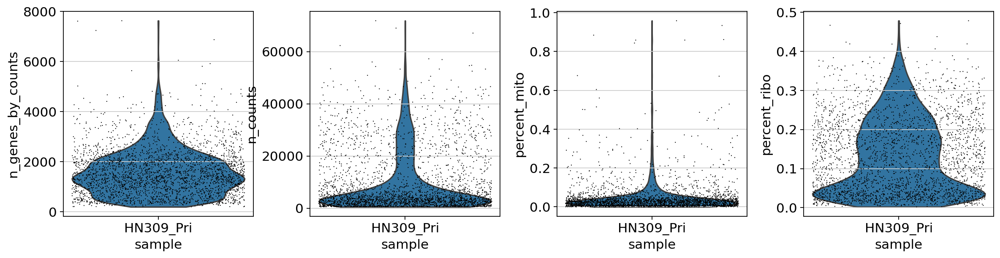

In [98]:
HN309_Pri = combined[combined.obs['sample']=='HN309_Pri']
sc.pl.violin(HN309_Pri, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


Filtered out 476 cells, number left in HN309_Pri is 2768


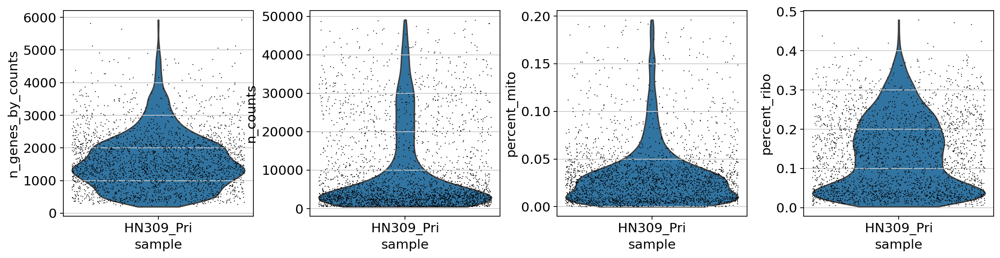

In [99]:
kept_cell['HN309_Pri'] = (combined.obs['n_genes_by_counts'] <6000) & (combined.obs['sample'] == 'HN309_Pri') & (combined.obs['n_counts'] <50000) & (combined.obs['percent_mito'] < 0.2)
print("Filtered out {} cells, number left in HN309_Pri is {}".format(number_filtered,str(sum(kept_cell['HN309_Pri']))))
sc.pl.violin(combined[kept_cell['HN309_Pri'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

## Cell-filtering for HN309_sLN

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


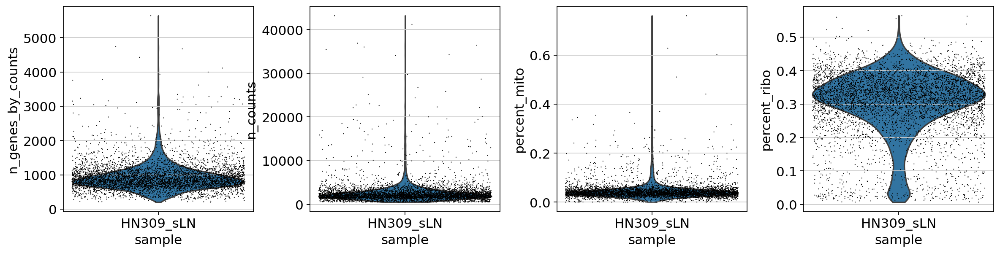

In [100]:
HN309_sLN = combined[combined.obs['sample']=='HN309_sLN']
sc.pl.violin(HN309_sLN, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


Filtered out 476 cells, number left in HN309_sLN is 4899


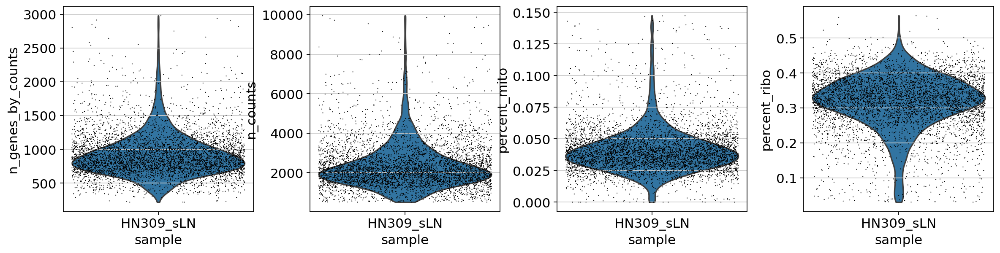

In [101]:
kept_cell['HN309_sLN'] = (combined.obs['n_genes_by_counts'] <3000) & (combined.obs['sample'] == 'HN309_sLN') & (combined.obs['n_counts'] <10000) & (combined.obs['percent_mito'] < 0.15)& (combined.obs['percent_ribo'] > 0.03)
print("Filtered out {} cells, number left in HN309_sLN is {}".format(number_filtered,str(sum(kept_cell['HN309_sLN']))))
sc.pl.violin(combined[kept_cell['HN309_sLN'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

## Cell-filtering for HN310

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


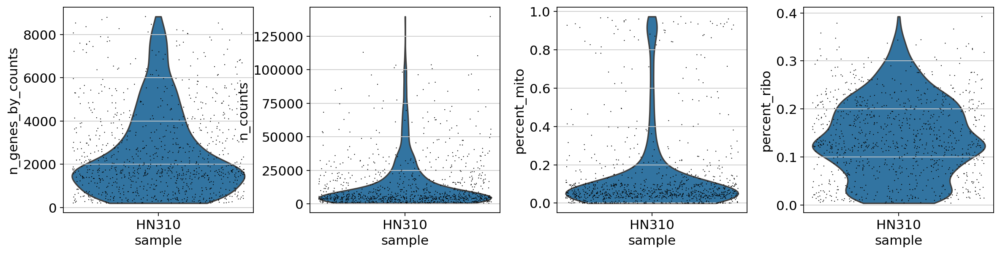

In [102]:
HN310 = combined[combined.obs['sample']=='HN310']
sc.pl.violin(HN310, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


Filtered out 476 cells, number left in HN310 is 911


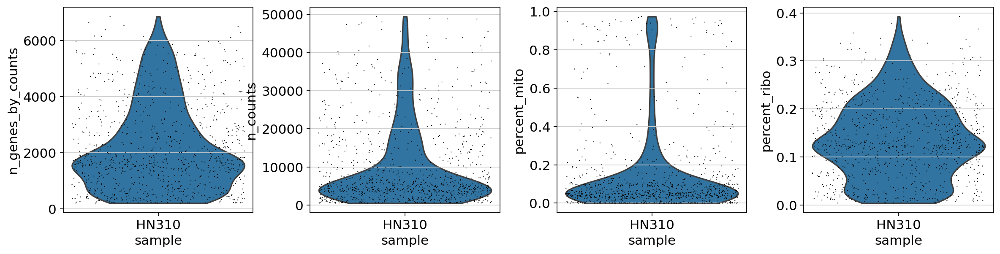

In [103]:
kept_cell['HN310'] = (combined.obs['n_genes_by_counts'] <10000) & (combined.obs['sample'] == 'HN310') & (combined.obs['n_counts'] <50000) 
print("Filtered out {} cells, number left in HN310 is {}".format(number_filtered,str(sum(kept_cell['HN310']))))
sc.pl.violin(combined[kept_cell['HN310'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

## Cell-filtering for HN313

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


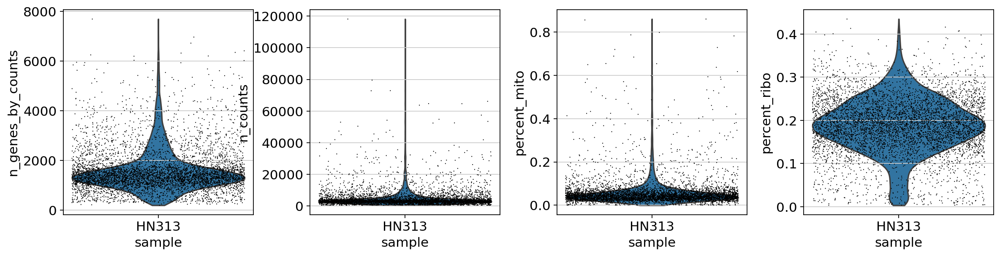

In [104]:
HN313 = combined[combined.obs['sample']=='HN313']
sc.pl.violin(HN313, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


Filtered out 476 cells, number left in HN313 is 4953


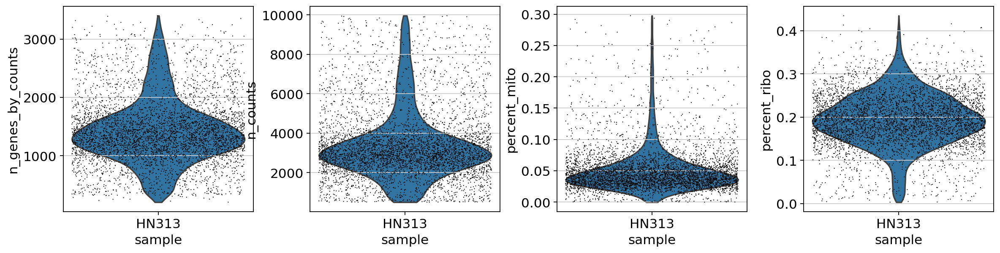

In [105]:
kept_cell['HN313'] = (combined.obs['n_genes_by_counts'] <8000) & (combined.obs['sample'] == 'HN313') & (combined.obs['n_counts'] <10000) & (combined.obs['percent_mito']<0.3) 
print("Filtered out {} cells, number left in HN313 is {}".format(number_filtered,str(sum(kept_cell['HN313']))))
sc.pl.violin(combined[kept_cell['HN313'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

## Cell-filtering for HN314

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


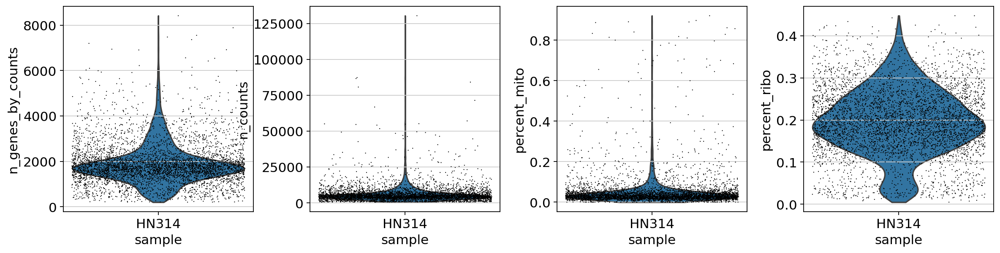

In [106]:
HN314 = combined[combined.obs['sample']=='HN314']
sc.pl.violin(HN314, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


Filtered out 476 cells, number left in HN314 is 4655


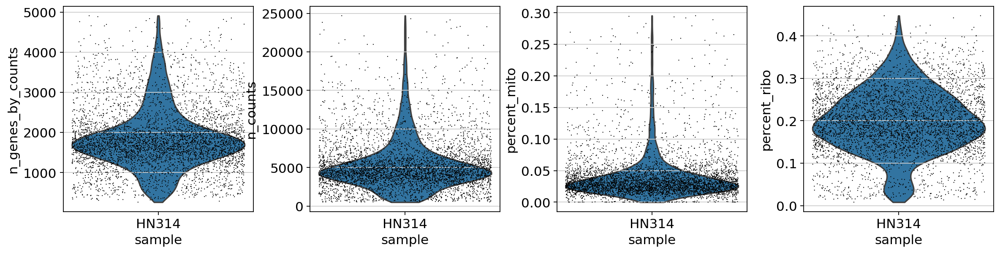

In [107]:
kept_cell['HN314'] = (combined.obs['n_genes_by_counts'] <5000) & (combined.obs['sample'] == 'HN314') & (combined.obs['n_counts'] <25000) & (combined.obs['percent_mito']<0.3) 
print("Filtered out {} cells, number left in HN314 is {}".format(number_filtered,str(sum(kept_cell['HN314']))))
sc.pl.violin(combined[kept_cell['HN314'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

## Cell-filtering for HN315

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


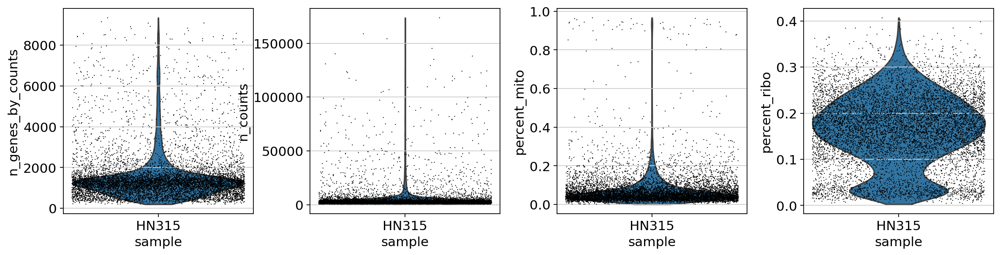

In [108]:
HN315 = combined[combined.obs['sample']=='HN315']
sc.pl.violin(HN315, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


Filtered out 476 cells, number left in HN314 is 8004


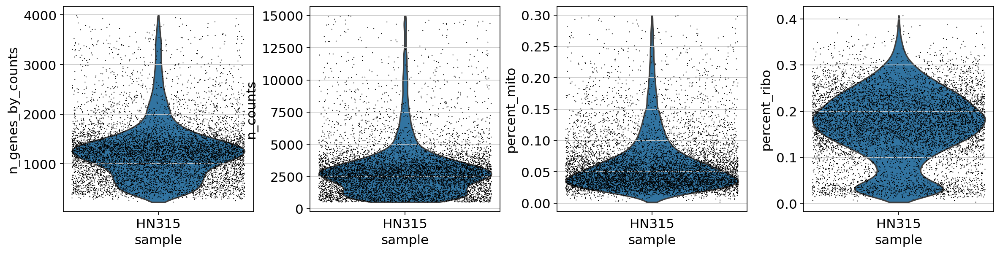

In [109]:
kept_cell['HN315'] = (combined.obs['n_genes_by_counts'] <4000) & (combined.obs['sample'] == 'HN315') & (combined.obs['n_counts'] <15000) & (combined.obs['percent_mito']<0.3) 
print("Filtered out {} cells, number left in HN314 is {}".format(number_filtered,str(sum(kept_cell['HN315']))))
sc.pl.violin(combined[kept_cell['HN315'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

## Cell-filtering for HN316

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


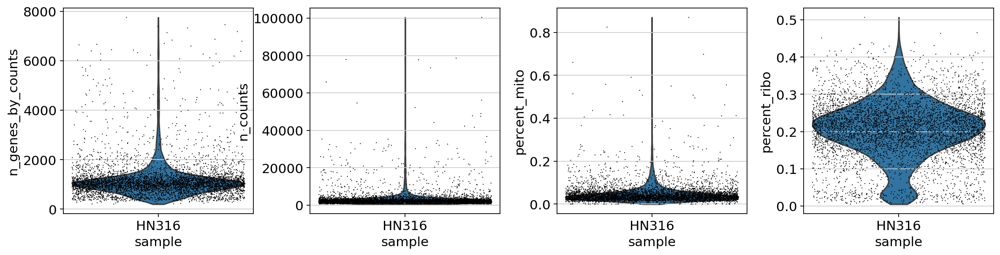

In [110]:
HN316 = combined[combined.obs['sample']=='HN316']
sc.pl.violin(HN316, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'group' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


Filtered out 476 cells, number left in HN314 is 8004


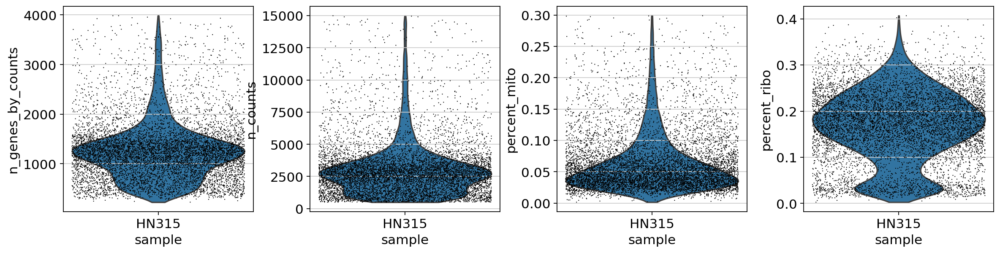

In [111]:
kept_cell['HN315'] = (combined.obs['n_genes_by_counts'] <4000) & (combined.obs['sample'] == 'HN315') & (combined.obs['n_counts'] <15000) & (combined.obs['percent_mito']<0.3) 
print("Filtered out {} cells, number left in HN314 is {}".format(number_filtered,str(sum(kept_cell['HN315']))))
sc.pl.violin(combined[kept_cell['HN315'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample')

In [112]:
combined_kept_cell = kept_cell['HN289_Pri']
for data_set in kept_cell:
    combined_kept_cell = combined_kept_cell | kept_cell[data_set]

combined =combined[combined_kept_cell,:]

# Gene Filtering

/usr/local/lib/python3.6/dist-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)


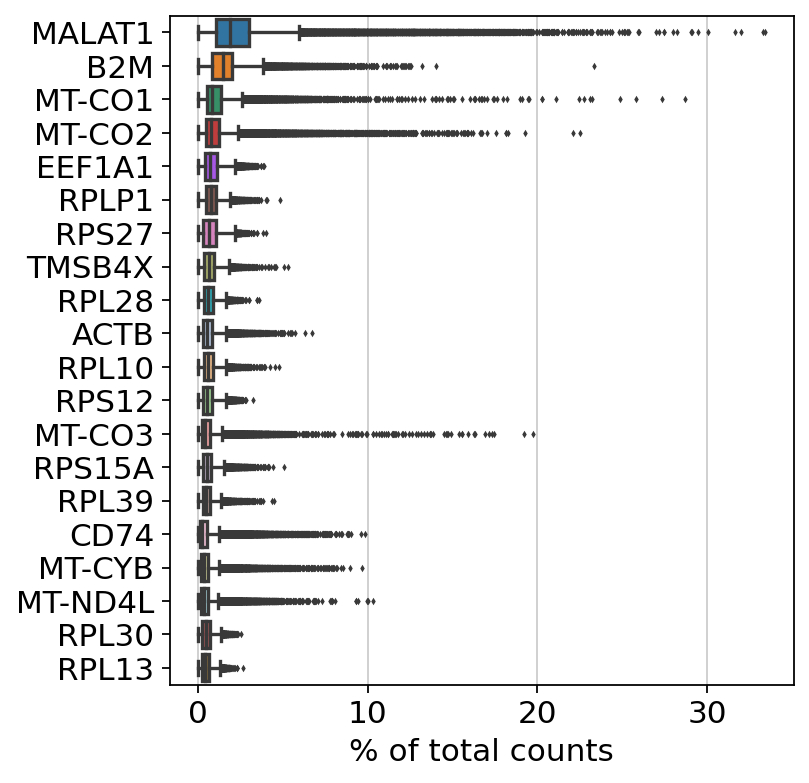

In [113]:
sc.pl.highest_expr_genes(combined, n_top=20)

A few things we can see:
(1) MALAT1 is the highest
(2) a lot of top genes are ribosomal or mitochondrial

As the level of expression of MALAT1 genes are much much higher (which goes up to 34%) than that of the rest genes, we do want to remove them from the dataset to before we encounter technical issues in further steps (due to normalization). We also want to remove mitochondrial genes which only concern dead/dying cells, and MALAT1 and ribosomal genes could create batch effects. There are other ways how these genes can affect downstream analysis results as well. However, before actually removing them, we do a careful check to make sure that these genes don't correpond to a lot of biological significance for samples

... storing 'sample' as categorical
... storing 'group' as categorical
... storing 'feature_types' as categorical


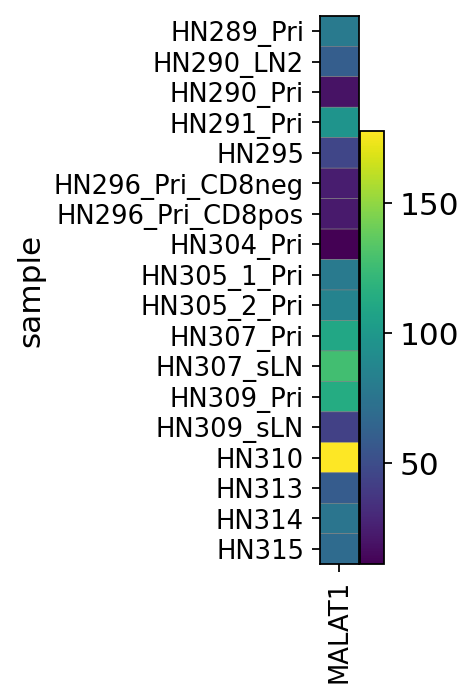

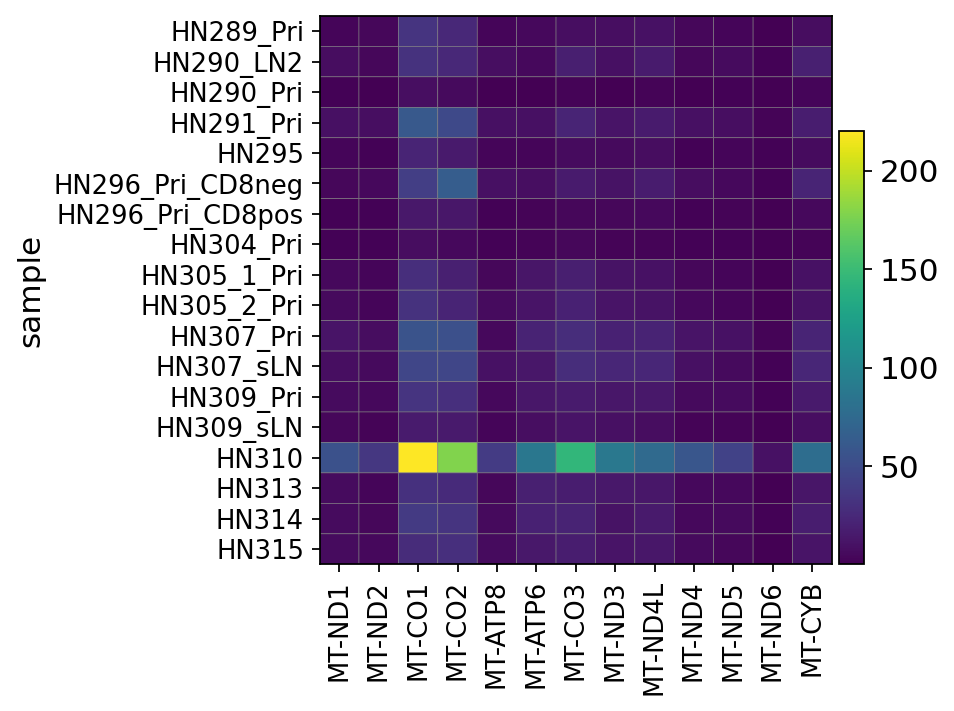

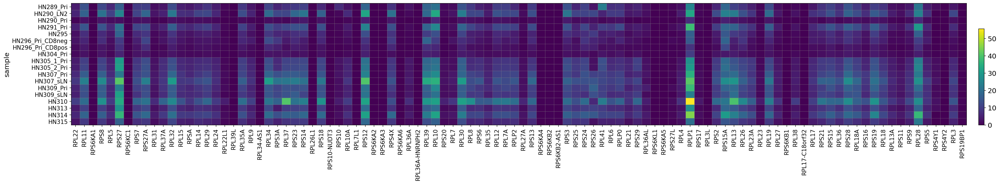

GridSpec(2, 3, height_ratios=[0, 10.5], width_ratios=[32.64, 0, 0.2])

In [114]:
# Look at the distribution of ribosomal genes and mitochondrial genes
 # since some genes have been filtered, we need to reselect mito and ribo from the remaining genes
ribo_genes = combined.var_names.str.startswith(("RPS","RPL"))
mito_genes = combined.var_names.str.startswith('MT-')
malat1 = combined.var_names.str.startswith('MALAT1')

sc.pl.matrixplot(combined, list(combined.var_names[malat1]), groupby='sample')
sc.pl.matrixplot(combined, list(combined.var_names[mito_genes]), groupby='sample')
sc.pl.matrixplot(combined, list(combined.var_names[ribo_genes]), groupby='sample')

Filter out MALAT1 and MT- genes which are irrelevant will affect downstream analysis

In [115]:
remove = np.add(ribo_genes,mito_genes)
remove = np.add(remove,malat1)

kept_genes = np.invert(remove)
combined = combined[:,kept_genes]

print("The number of cells and genes left: {},{}".format(combined.n_obs, combined.n_vars))

The number of cells and genes left: 64441,25552


/usr/local/lib/python3.6/dist-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)


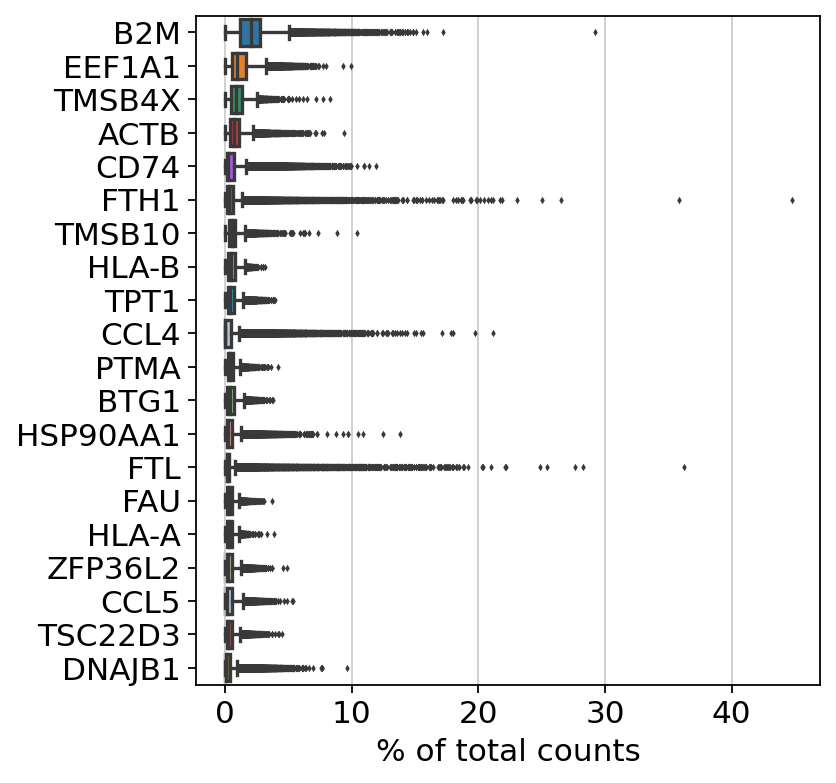

In [116]:
sc.pl.highest_expr_genes(combined, n_top=20)

In [117]:
save_file = '/scratch/qc_filtered_combined_samples.h5ad'
combined.write_h5ad(save_file)